In [38]:
from random import uniform as rd
from itertools import product
import matplotlib.pyplot as plt
import numpy as np
import copy
import threading as th
import pandas as pd

In [39]:
def X(n=2, d=2):
    """
    Génère toutes les combinaisons de `d` indices allant de 0 à n-1,
    sous forme de floats.
    """
    return [ [float(x) for x in t] for t in product(range(n), repeat=d) ]

def signe(x):
  if x > 0:
    return 1
  else:
    return -1


def f_OU(x):
  n = len(x)
  f_x = -1

  for i in range(n):
    if x[i] == 1:
      f_x = 1
      return f_x
    else:
      pass
  return f_x


def f_AND(x):
  n = len(x)

  f_x = 1
  for i in range(n):
    if x[i] == 0:
      f_x = -1
      return f_x
    else:
      pass
  return f_x

def f_XOR(x):
    result = 0
    for bit in x:
        result ^= int(bit)  # XOR bit à bit
    return 1 if result == 1 else -1


In [40]:
def L (f, X_ens):
  L_ens = []
  for n in range(len(X_ens)):
    L_ens.append([X_ens[n],f(X_ens[n][1:])]) #Le biais (x_0 = 1) est exclus du calcul de la fonction booleenne
  return L_ens

In [41]:
N = 2
X_ens = X(2, N)
X_ens = [[1.0] + x for x in X_ens]

In [42]:
print(X_ens)

[[1.0, 0.0, 0.0], [1.0, 0.0, 1.0], [1.0, 1.0, 0.0], [1.0, 1.0, 1.0]]


In [43]:
L_OU = L(f_OU, X_ens)
L_AND = L(f_AND, X_ens)
L_XOR = L(f_XOR, X_ens)

print(L_OU)
print(L_AND)
print(L_XOR)

[[[1.0, 0.0, 0.0], -1], [[1.0, 0.0, 1.0], 1], [[1.0, 1.0, 0.0], 1], [[1.0, 1.0, 1.0], 1]]
[[[1.0, 0.0, 0.0], -1], [[1.0, 0.0, 1.0], -1], [[1.0, 1.0, 0.0], -1], [[1.0, 1.0, 1.0], 1]]
[[[1.0, 0.0, 0.0], -1], [[1.0, 0.0, 1.0], 1], [[1.0, 1.0, 0.0], 1], [[1.0, 1.0, 1.0], -1]]


In [44]:
def f_init_Hebb(L_ens, biais):
  p = len(L_ens)
  dim = len(L_ens[0][0])

  w = []
  for i in range(dim):
    w.append(0.0)

  for k in range(p):
    w[0] = biais # Biais
    for i in range(1,dim):
      w[i] = w[i] + L_ens[k][0][i]*L_ens[k][1]

  return w

def f_init_rand(L_ens, biais):
  p = len(L_ens)
  dim = len(L_ens[0][0])

  w = []
  for i in range(dim):
    w.append(0.0)

  w[0] = biais #Ajout du biais
  for i in range(1,dim):
    w[i] = (rd(-1,1))

  return w

In [45]:
def plot_L_et_w_bias_first(L_ens, w_k):
    """
    L_ens: liste de tuples (x, t) où x = [1, x1, x2] (biais en premier)
    w_k: [w0, w1, w2] où w0 est le biais
    """
    # Extraire les points (sauter le 1 du biais)
    x1_vals = [x[1] for x, t in L_ens]
    x2_vals = [x[2] for x, t in L_ens]
    labels = [t for x, t in L_ens]

    # Créer le plot
    plt.figure(figsize=(8, 6))

    # Tracer les points
    colors = ['red' if t == -1 else 'blue' for t in labels]
    plt.scatter(x1_vals, x2_vals, c=colors, s=100, alpha=0.7,
                label=f'Classe -1 (rouge) / +1 (bleu)')

    # Tracer la droite de décision
    w0, w1, w2 = w_k[0], w_k[1], w_k[2]

    # Générer des points pour la droite
    x1_min, x1_max = min(x1_vals), max(x1_vals)

    if abs(w2) > 1e-10:  # w2 ≠ 0
        # w1*x1 + w2*x2 + w0 = 0 → x2 = -(w1*x1 + w0)/w2
        x1_line = np.array([x1_min - 1, x1_max + 1])
        x2_line = -(w1 * x1_line + w0) / w2
    else:  # droite verticale
        x_fixed = -w0 / w1
        x2_min, x2_max = min(x2_vals), max(x2_vals)
        x1_line = np.array([x_fixed, x_fixed])
        x2_line = np.array([x2_min - 1, x2_max + 1])

    plt.plot(x1_line, x2_line, 'k-', linewidth=3, label=f'{w1:.2f}·x1 + {w2:.2f}·x2 + {w0:.2f} = 0')

    # Ajouter des indications
    plt.xlabel('x1')
    plt.ylabel('x2')
    plt.title('Perceptron - Frontière de décision')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.axis('equal')

    # Afficher les poids
    print(f"Équation de la droite: {w1:.3f}·x1 + {w2:.3f}·x2 + {w0:.3f} = 0")
    print(f"Vecteur normal (orthogonal à la droite): ({w1:.3f}, {w2:.3f})")
    print(f"Vecteur directeur (le long de la droite): ({-w2:.3f}, {w1:.3f})")

    plt.show()
    return w0, w1, w2

def plot_L_et_w_multiple(L_ens, W_array):
    """
    L_ens: list of tuples (x, t) where x = [1, x1, x2] (bias first)
    W_array: array-like of shape (num_vectors, 3)
        W_array[0] is the teacher (red)
        Other rows are perceptrons
    """
    # Extract points (skip bias)
    x1_vals = [x[1] for x, t in L_ens]
    x2_vals = [x[2] for x, t in L_ens]
    labels_points = [t for x, t in L_ens]

    # Plot points
    plt.figure(figsize=(10, 6))
    colors_points = ['red' if t == -1 else 'blue' for t in labels_points]
    plt.scatter(x1_vals, x2_vals, c=colors_points, s=100, alpha=0.7,
                label='Classe -1 (rouge) / +1 (bleu)')

    # Colors for perceptrons (skip red)
    num_vectors = W_array.shape[0]
    rng = np.random.default_rng()
    perceptron_colors = rng.uniform(0, 1, size=(num_vectors-1, 3))  # RGB

    # Plot all lines
    for i, w_k in enumerate(W_array):
        w0, w1, w2 = w_k[0], w_k[1], w_k[2]
        x1_min, x1_max = min(x1_vals), max(x1_vals)

        if abs(w2) > 1e-10:  # w2 != 0
            x1_line = np.array([x1_min - 1, x1_max + 1])
            x2_line = -(w1 * x1_line + w0) / w2
        else:  # vertical line
            x_fixed = -w0 / w1
            x2_min, x2_max = min(x2_vals), max(x2_vals)
            x1_line = np.array([x_fixed, x_fixed])
            x2_line = np.array([x2_min - 1, x2_max + 1])

        if i == 0:  # teacher
            plt.plot(x1_line, x2_line, 'r-', linewidth=2, label='teacher')  # thinner
        else:
            plt.plot(x1_line, x2_line, color=perceptron_colors[i-1], linewidth=1.5,
                     label=f'perceptron_{i}')  # thinner

    plt.xlabel('x1')
    plt.ylabel('x2')
    plt.title('Perceptron - Frontières de décision')
    plt.grid(True, alpha=0.3)
    plt.axis('equal')

    # Move legend outside
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.tight_layout()
    plt.show()

def plot_L_et_w_multiple_fixed_axes(L_ens, W_array, xlim=None, ylim=None):
    """
    Version avec limites x et y séparées.

    xlim: tuple (x_min, x_max) ou None
    ylim: tuple (y_min, y_max) ou None
    """

    # Extraire points
    x1_vals = [x[1] for x, t in L_ens]
    x2_vals = [x[2] for x, t in L_ens]
    labels = [t for x, t in L_ens]

    # Graphique
    plt.figure(figsize=(10, 8))

    # Points
    colors = ['red' if t == -1 else 'blue' for t in labels]
    plt.scatter(x1_vals, x2_vals, c=colors, s=100, alpha=0.7,
                label='Classe -1 (rouge) / +1 (bleu)')

    # Limites automatiques si non spécifiées
    if xlim is None:
        x_min, x_max = min(x1_vals), max(x1_vals)
        x_margin = (x_max - x_min) * 0.2
        xlim = (x_min - x_margin, x_max + x_margin)

    if ylim is None:
        y_min, y_max = min(x2_vals), max(x2_vals)
        y_margin = (y_max - y_min) * 0.2
        ylim = (y_min - y_margin, y_max + y_margin)

    # Étendue pour calculer les droites (plus grande que l'affichage)
    x_line_range = np.array([xlim[0] - 10, xlim[1] + 10])

    # Tracer chaque droite
    num_vectors = len(W_array)
    colors_vectors = plt.cm.rainbow(np.linspace(0, 1, max(2, num_vectors)))

    for i, w in enumerate(W_array):
        w0, w1, w2 = w[0], w[1], w[2]

        if abs(w2) > 1e-10:
            y_line = -(w1 * x_line_range + w0) / w2
        else:
            x_fixed = -w0 / w1
            x_line_range = np.array([x_fixed, x_fixed])
            y_line = np.array([ylim[0] - 10, ylim[1] + 10])

        if i == 0:
            plt.plot(x_line_range, y_line, 'r-', linewidth=3, label='Professeur')
        else:
            plt.plot(x_line_range, y_line, color=colors_vectors[i],
                     linewidth=1.5, linestyle='--', label=f'Élève {i}')

    # FORCER les limites
    plt.xlim(xlim[0], xlim[1])
    plt.ylim(ylim[0], ylim[1])

    # Origine
    plt.scatter([0], [0], color='green', s=100, marker='*', label='Origine')

    plt.xlabel('x1')
    plt.ylabel('x2')
    plt.title(f'Perceptron - {num_vectors} vecteurs (axes fixés)')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

In [46]:
#Definition des conditions initiales
biais = 1.0

L_ens = L_XOR

w_k = f_init_rand(L_OU, biais)
#w_k = f_init_Hebb(L_ens, biais)
#w_k_test = [3, 2, 5] #w0, w1, w2


[1.0, -0.7021964890198644, -0.014118879276210805]
Équation de la droite: -0.702·x1 + -0.014·x2 + 1.000 = 0
Vecteur normal (orthogonal à la droite): (-0.702, -0.014)
Vecteur directeur (le long de la droite): (0.014, -0.702)


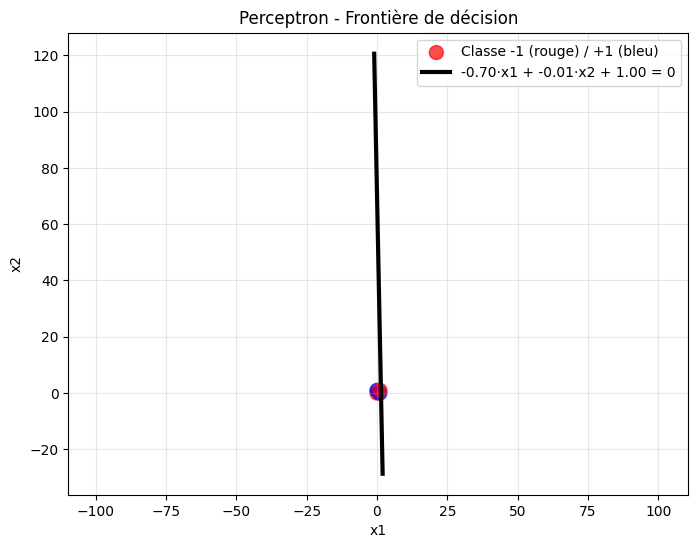

(1.0, -0.7021964890198644, -0.014118879276210805)

In [47]:
print(w_k)
plot_L_et_w_bias_first(L_ens, w_k)

In [ ]:
def perceptron_online(w_vect, L_ens, eta):
  #print("in perceptron online")

  w_k = copy.deepcopy(w_vect)
  stop = 0
  while stop < 50:     # boucle sur les époques
    #print('\n'*2, '_'*20, '\n')
    #print("stop =", stop)
    nb_mal_classe = 0

    for k in range(len(L_ens)):   # boucle sur les exemples
        x_k = L_ens[k][0]
        t = L_ens[k][1]

        # produit scalaire
        w_k_scal_x_k = sum(w_k[i] * x_k[i] for i in range(len(x_k)))

        y = 1 if w_k_scal_x_k > 0 else -1
        #print("y = ", y)
        #print("t = ", t)
        if y != t:

            delta_w = eta * (t - y)
            for i in range(len(x_k)):
                w_k[i] += delta_w * x_k[i]
            nb_mal_classe += 1

    # fin de l'époque : vérification arrêt
    if nb_mal_classe == 0:
        print("Convergence atteinte.")
        stop += 1
        break
    else:
        print("nb_mal_classe : ", nb_mal_classe)
        stop += 1


  print("in perceptron online - return")
  return w_k, stop-1


def perceptron_batch(w_vect, L_ens, eta):
  print("in perceptron online")

  w_k = copy.deepcopy(w_vect)
  stop = 0

  delta_w = np.zeros(len(w_vect))

  while stop < 50:     # boucle sur les époques
    print('\n'*2, '_'*20, '\n')
    print("stop =", stop)
    nb_mal_classe = 0

    delta_w = np.zeros(len(w_vect))

    for k in range(len(L_ens)):   # boucle sur les exemples
        x_k = L_ens[k][0]
        t = L_ens[k][1]

        # produit scalaire
        w_k_scal_x_k = sum(w_k[i] * x_k[i] for i in range(len(x_k)))
        y = 1 if w_k_scal_x_k > 0 else -1

        print("y = ", y)
        print("t = ", t)

        if y != t:
            for i in range(len(x_k)):
                delta_w[i] = delta_w[i] + eta * (t - y)*x_k[i]
            nb_mal_classe += 1

    # fin de l'époque : vérification arrêt
    w_k += delta_w

    if nb_mal_classe == 0:
        print("Convergence atteinte.")
        stop += 1
        break
    else:
        print("nb_mal_classe : ", nb_mal_classe)
        stop += 1

  print("in perceptron online - return")
  return w_k, stop-1

In [49]:
eta = 0.14
w_k,_ = perceptron_online(w_k, L_ens, eta)
print("w_k:", w_k)

in perceptron online


 ____________________ 

stop = 0
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  -1
nb_mal_classe :  2


 ____________________ 

stop = 1
y =  1
t =  -1
y =  -1
t =  1
y =  -1
t =  1
y =  1
t =  -1
nb_mal_classe :  4


 ____________________ 

stop = 2
y =  1
t =  -1
y =  -1
t =  1
y =  -1
t =  1
y =  1
t =  -1
nb_mal_classe :  4


 ____________________ 

stop = 3
y =  1
t =  -1
y =  -1
t =  1
y =  -1
t =  1
y =  1
t =  -1
nb_mal_classe :  4


 ____________________ 

stop = 4
y =  1
t =  -1
y =  -1
t =  1
y =  -1
t =  1
y =  1
t =  -1
nb_mal_classe :  4


 ____________________ 

stop = 5
y =  1
t =  -1
y =  -1
t =  1
y =  -1
t =  1
y =  1
t =  -1
nb_mal_classe :  4


 ____________________ 

stop = 6
y =  1
t =  -1
y =  -1
t =  1
y =  -1
t =  1
y =  1
t =  -1
nb_mal_classe :  4


 ____________________ 

stop = 7
y =  1
t =  -1
y =  -1
t =  1
y =  -1
t =  1
y =  1
t =  -1
nb_mal_classe :  4


 ____________________ 

stop = 8
y =  1
t =  -1
y =  -1
t =  1
y = 

Poids finaux (biais en premier): [0.43999999999999995, -0.9821964890198644, -0.29411887927621083]
Équation de la droite: -0.982·x1 + -0.294·x2 + 0.440 = 0
Vecteur normal (orthogonal à la droite): (-0.982, -0.294)
Vecteur directeur (le long de la droite): (0.294, -0.982)


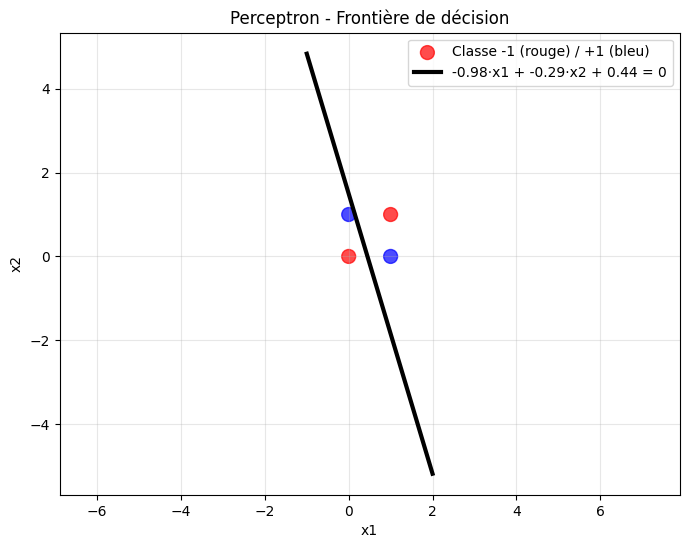

(0.43999999999999995, -0.9821964890198644, -0.29411887927621083)

In [50]:
print("Poids finaux (biais en premier):", w_k)
plot_L_et_w_bias_first(L_ens, w_k)

In [51]:
#Definition des conditions initiales
biais = 1.0

#w_k = f_init_rand(L_OU, biais)
#w_k = f_init_Hebb(L_OU, biais)
w_k = [3, 2, 5] #w0, w1, w2
L_ens = L_OU

eta = 0.14
w_k,_ = perceptron_batch(w_k, L_ens, eta)
print("w_k:", w_k)

in perceptron online


 ____________________ 

stop = 0
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 1
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 2
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 3
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 4
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 5
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 6
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 7
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 8
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1

Poids finaux (biais en premier): [-0.08  2.    5.  ]
Équation de la droite: 2.000·x1 + 5.000·x2 + -0.080 = 0
Vecteur normal (orthogonal à la droite): (2.000, 5.000)
Vecteur directeur (le long de la droite): (-5.000, 2.000)


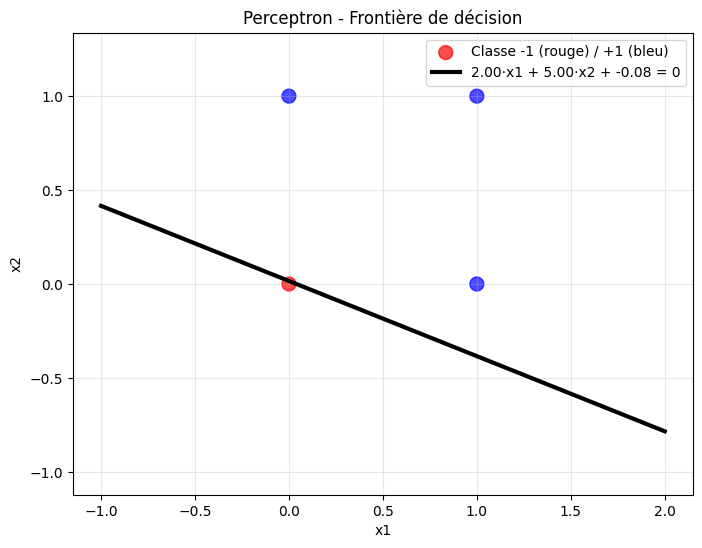

(np.float64(-0.08000000000000096), np.float64(2.0), np.float64(5.0))

In [52]:
print("Poids finaux (biais en premier):", w_k)
plot_L_et_w_bias_first(L_ens, w_k)

In [53]:
#Perceptron Professeur
N = 2
X_prof = X(2, N)

#Ajout du  bais
X_prof_N_1 = [[1.0] + x for x in X_prof]

print(X_prof_N_1)

[[1.0, 0.0, 0.0], [1.0, 0.0, 1.0], [1.0, 1.0, 0.0], [1.0, 1.0, 1.0]]


In [54]:
def init_perceptron_prof(N, biais_range=(-10e6, 10e6)):
  w_prof = np.zeros(N+1)

  biais_min, biais_max = biais_range
  w_prof[0] = np.random.uniform(biais_min, biais_max)
  for i in range(1,len(w_prof)):
      w_prof[i] = (rd(biais_min, biais_max))
  return w_prof

w_prof = init_perceptron_prof(N)
print(w_prof)

[-6769682.69322577  7048661.8965377  -7134305.26290645]


In [55]:
def L_prof(X, w_prof):
  L_ens = []
  for x in X:
    L_ens.append([x,signe(np.dot(x, w_prof))])
  return L_ens

In [56]:
#w_prof=[-20,50.0,200.0]
w_prof = init_perceptron_prof(2)
L_ens = L_prof(X_prof_N_1, w_prof)
print(L_ens)

[[[1.0, 0.0, 0.0], 1], [[1.0, 0.0, 1.0], 1], [[1.0, 1.0, 0.0], 1], [[1.0, 1.0, 1.0], 1]]


Équation de la droite: 3635810.205·x1 + 5438238.798·x2 + 7669957.928 = 0
Vecteur normal (orthogonal à la droite): (3635810.205, 5438238.798)
Vecteur directeur (le long de la droite): (-5438238.798, 3635810.205)


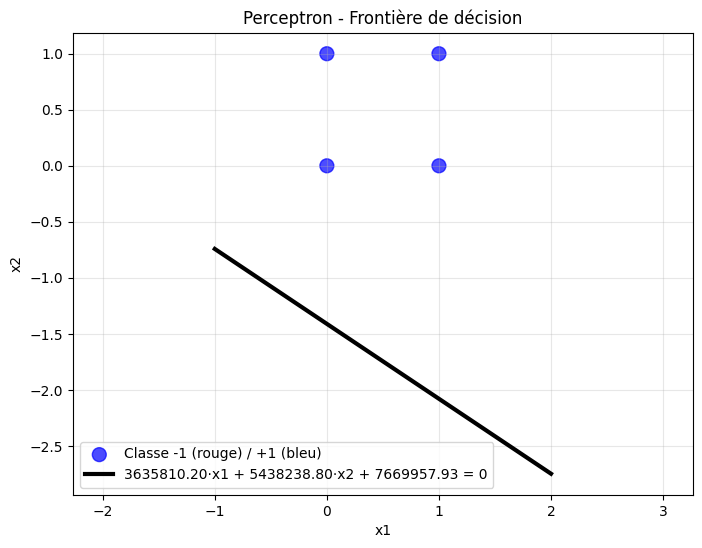

(np.float64(7669957.928363152),
 np.float64(3635810.204623701),
 np.float64(5438238.797620198))

In [57]:
plot_L_et_w_bias_first(L_ens, w_prof)

In [58]:
def init_many_perceptrons(qte, N, biais_range=(-10e6, 10e6)):
  # Initialisation : N poids par perceptron (SANS biais)
  #W_many_perceptrons = np.zeros((qte, N))
  borne_min, borne_max = biais_range
  W_many_perceptrons = np.random.uniform(borne_min, borne_max, size=(qte, N))

  # Créer un nouveau array avec N+1 colonnes (N poids + biais)
  W_avec_biais = np.zeros((qte, N + 1))

  biais_min, biais_max = biais_range

  for j in range(qte):
      # Mettre le biais en première position
      W_avec_biais[j, 0] = np.random.uniform(biais_min, biais_max)
      # Copier les anciens poids aux positions 1 à N+1
      W_avec_biais[j, 1:] = W_many_perceptrons[j]

  # Remplacer l'ancienne matrice
  return W_avec_biais


qte = 20
biais_range = (-20, 20)
W_perceptrons = init_many_perceptrons(qte, N, biais_range)

print(len(W_perceptrons))
print(W_perceptrons)

W_perceptron_batch = init_many_perceptrons(qte, N, biais_range)




20
[[ -1.68760041  -4.78039038   8.16185446]
 [  1.92897435 -15.06915095  -8.06856854]
 [-13.39841737   8.08202898  -4.27318907]
 [  5.40071354 -10.42070373   8.48426753]
 [  3.71574002   9.51949236   4.29725745]
 [ -9.92804117 -11.16736677  -7.32594587]
 [ 18.8335055  -11.25700213 -10.67454799]
 [  1.68633891  10.04072655  17.58659588]
 [-10.08864751  -4.21804109 -16.78618072]
 [ -8.10400101  -5.17542462  18.86648584]
 [ 15.17536496   1.5223336   -0.24857656]
 [ 10.47473869   6.07477761  19.62384985]
 [  5.09594536  17.27302443   5.52331288]
 [ 13.45127579   6.5103758   -7.5270081 ]
 [-17.00257828 -13.74616795  -2.61348814]
 [ -7.59723254  15.97312649 -11.11827603]
 [-16.22845351 -17.59607    -15.16190994]
 [-12.61654442  -2.03296018  -1.67719636]
 [ -5.27296815  12.30777748  17.56327676]
 [  0.96741869  14.56846317   8.4909362 ]]


In [59]:
def create_points(nbPoints, N, bornes=(-10e6,10e6)): #Ajout de 1.0 au début pour le biais
  points = []
  borne_min, borne_max = bornes
  for p in range(nbPoints):
    point = []
    point.append(1.0) #Le biais
    for i in range(N):
      x_i = rd(borne_min, borne_max)
      point.append(x_i)
    points.append(point)

  return points

nbPoints = 10
N = 4
points = create_points(nbPoints, N)

In [60]:
def recouvrement(vect1, vect2):
  produit_scalaire = np.dot(vect1, vect2)
  norme_vect_1 = np.linalg.norm(vect1)
  norme_vect_2 = np.linalg.norm(vect2)

  R = ( produit_scalaire / (norme_vect_1*norme_vect_2) )

  return R


vect1 = np.array([1,0])
vect2 = np.array([0,-1])

R = recouvrement(vect1, vect2)
print(R)

0.0


[ 6.50127004  3.40990319 -8.94116494]
Équation de la droite: 3.410·x1 + -8.941·x2 + 6.501 = 0
Vecteur normal (orthogonal à la droite): (3.410, -8.941)
Vecteur directeur (le long de la droite): (8.941, 3.410)


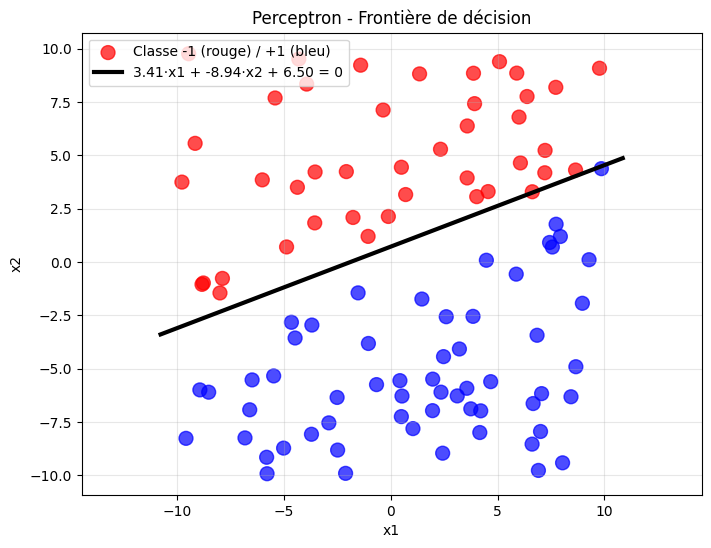

(np.float64(6.5012700375051615),
 np.float64(3.40990318639815),
 np.float64(-8.941164937282034))

In [61]:
P = 100
N = 2

bornes = (-10,10)

#Créer P points de dimension N+1 (pour le biais)
points = create_points(P, N, bornes)

w_prof = init_perceptron_prof(2, bornes)

print(w_prof)
#Création de l'ensemble d'apprentissage L_prof avec w_prof
L_ens = L_prof(points, w_prof)

plot_L_et_w_bias_first(L_ens, w_prof)

in perceptron online


 ____________________ 

stop = 0
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  -1
y =  -1
t =  1
y =  1
t =  1
y =  -1
t =  1
y =  -1
t =  1
y =  -1
t =  -1
y =  -1
t =  -1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  -1
t =  -1
y =  1
t =  1
y =  -1
t =  -1
y =  -1
t =  -1
y =  1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  -1
y =  -1
t =  -1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  -1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  -1
t =  -1
y =  -1
t =  -1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  -1
t =  -1
y =  -1


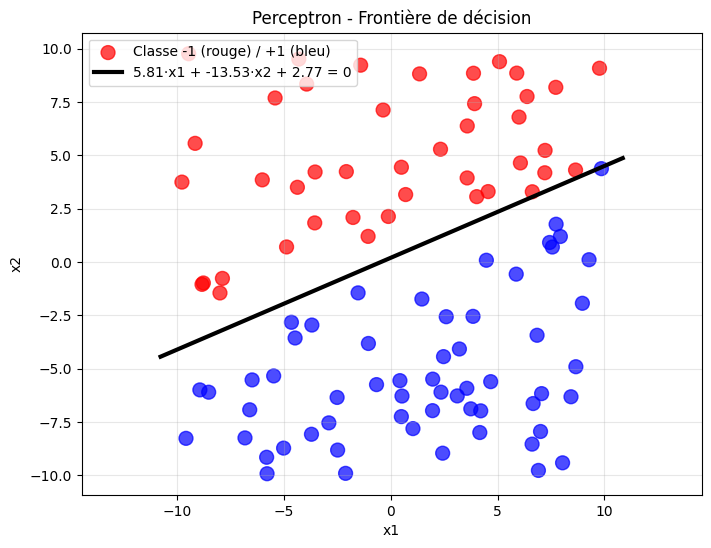

(np.float64(2.7689743508263556),
 np.float64(5.812195352333786),
 np.float64(-13.52668650945567))

In [62]:
#Entraine un perceptron sur L_ens créé par L_prof()
def train_perceptron (perceptron, L_ens, eta, algorithme):
  #modifier les deux algos pour qu'il retourne les nbIter
  if algorithme == "online":
    perceptron, nbIter = perceptron_online(perceptron, L_ens, eta)
  elif algorithme == "batch":
    perceptron, nbIter = perceptron_batch(perceptron, L_ens, eta)

  return perceptron, nbIter

perceptron = W_perceptrons[1]

perceptron, nbIter = train_perceptron(perceptron, L_ens, eta, "online")
print(perceptron)
print(nbIter)

print("Poids finaux (biais en premier):", w_k)
plot_L_et_w_bias_first(L_ens, perceptron)


In [63]:
def make_tirage(W_many_perceptrons, w_prof, eta, N, P, bornes, algorithme, points = None):

  local_W_many_perceptrons = copy.deepcopy(W_many_perceptrons)
  nb_perceptron = len(local_W_many_perceptrons)
  moyennes = np.zeros((nb_perceptron, 2))

  #Créer P points de dimension N+1 (pour le biais)
  if points is None:
    borne_min, borne_max = bornes
    points = create_points(P, N, bornes)

  #Création de l'ensemble d'apprentissage L_prof avec w_prof
  L_ens = L_prof(points, w_prof)

  #Entrainement en // des 20 Perceptrons : index 'l'
  threads = []
  results = [None] * nb_perceptron

  def worker(l):
    perceptron = local_W_many_perceptrons[l]
    new_weights, nbIter = train_perceptron(perceptron, L_ens, eta, algorithme)
    R = recouvrement(w_prof, new_weights)
    results[l] = (nbIter, R, new_weights)

  for l in range(nb_perceptron):
    t = th.Thread(target=worker, args=(l,))
    t.start()
    threads.append(t)

  for t in threads:
    t.join()

  for l in range(nb_perceptron):
    nbIter, R, new_w = results[l]
    local_W_many_perceptrons[l] = new_w
    print("\n","-"*20, "\n")
    print("nbIter :", nbIter)
    print("R :", R)
    print("\n","-"*20, "\n")
    moyennes[l, 0] = nbIter
    moyennes[l, 1] = R

  return local_W_many_perceptrons, moyennes, L_ens

In [64]:
N = 2
P = 10
nb_perceptrons = 20

biais_range = (-20,20)

W_perceptrons = init_many_perceptrons(nb_perceptrons, N, biais_range)
w_prof = init_perceptron_prof(N, biais_range)

eta0 = 0.8

In [65]:
points = create_points(P, N, biais_range)

In [66]:
algorithme = "online"
trained_perceptrons, moyennes, L_ens = make_tirage(W_perceptrons, w_prof, eta, N, P, biais_range, algorithme, points)

in perceptron online


 ____________________ 

stop = 0
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  -1
nb_mal_classe :  2


 ____________________ 

stop = 1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
Convergence atteinte.
in perceptron online - return
in perceptron online


 ____________________ 

stop = 0
y =  1
t =  1
y =  -1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  1
y =  -1
t =  -1
nb_mal_classe :  2


 ____________________ 

stop = 1
y =  1
t =  1
y =  -1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
nb_mal_classe :  1


 ____________________ 

stop = 2
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t 

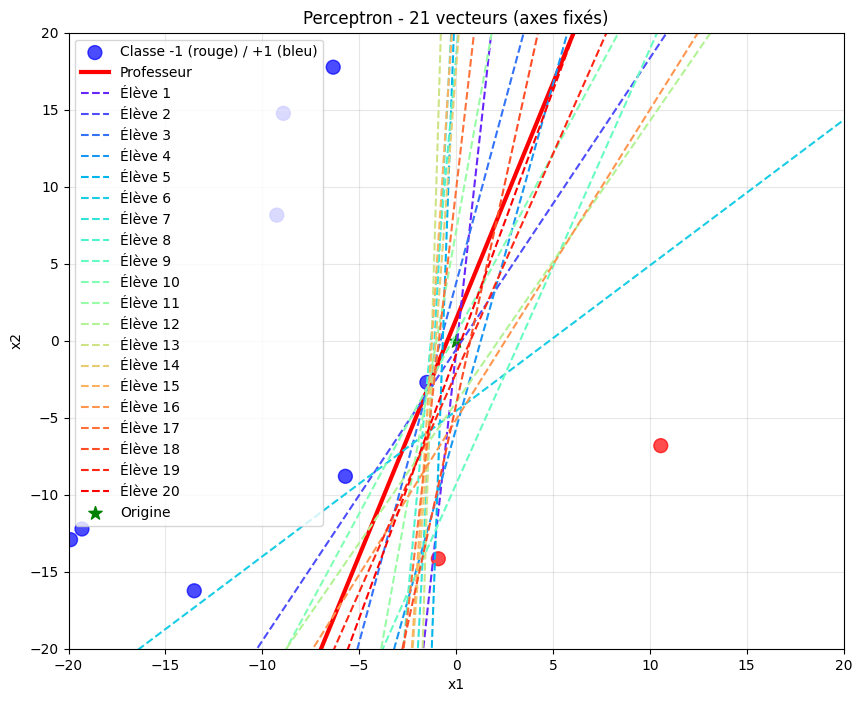

In [67]:
all_array = np.vstack([w_prof,trained_perceptrons])

x_lim = 20
y_lim = 20
plot_L_et_w_multiple_fixed_axes(L_ens, all_array, (-x_lim, x_lim), (-y_lim, y_lim))


In [68]:
df_nbIter=pd.DataFrame(moyennes,columns=['Nbre_iter_convergence', 'Recouvrement R'])
df_nbIter.index.name = 'Perceptron #'
print(df_nbIter)

Nb_iter_moyen, R_moyen = np.mean(moyennes[:, 0]), np.mean(moyennes[:, 1])
print("-"*20, '\n' )
print("Nb_iter_moyen :", Nb_iter_moyen)
print("R_moyen :", R_moyen)

              Nbre_iter_convergence  Recouvrement R
Perceptron #                                       
0                               1.0        0.869672
1                               2.0        0.774331
2                               3.0        0.962685
3                               3.0        0.267097
4                               1.0        0.949817
5                               1.0       -0.141755
6                               8.0        0.884594
7                              11.0        0.854934
8                               1.0       -0.091398
9                               1.0        0.969344
10                              4.0        0.917913
11                              1.0        0.069802
12                              1.0        0.855591
13                              4.0        0.897967
14                              7.0        0.861505
15                              1.0        0.006497
16                              2.0        0.931751
17          

In [69]:
algorithme = "batch"
trained_perceptrons, moyennes, L_ens = make_tirage(W_perceptrons, w_prof, eta, N, P, biais_range, algorithme, points)

in perceptron online


 ____________________ 

stop = 0
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  -1
nb_mal_classe :  2


 ____________________ 

stop = 1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
Convergence atteinte.
in perceptron online - return
in perceptron online


 ____________________ 

stop = 0
y =  1
t =  1
y =  -1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  1
y =  -1
t =  1
y =  -1
t =  -1
nb_mal_classe :  3


 ____________________ 

stop = 1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
Convergence atteinte.
in perceptron online - return
in perceptron online


 ____________________ 

stop = 0
y =  -1
t =  1
y =  -1
t =  1
y =  1
t = 

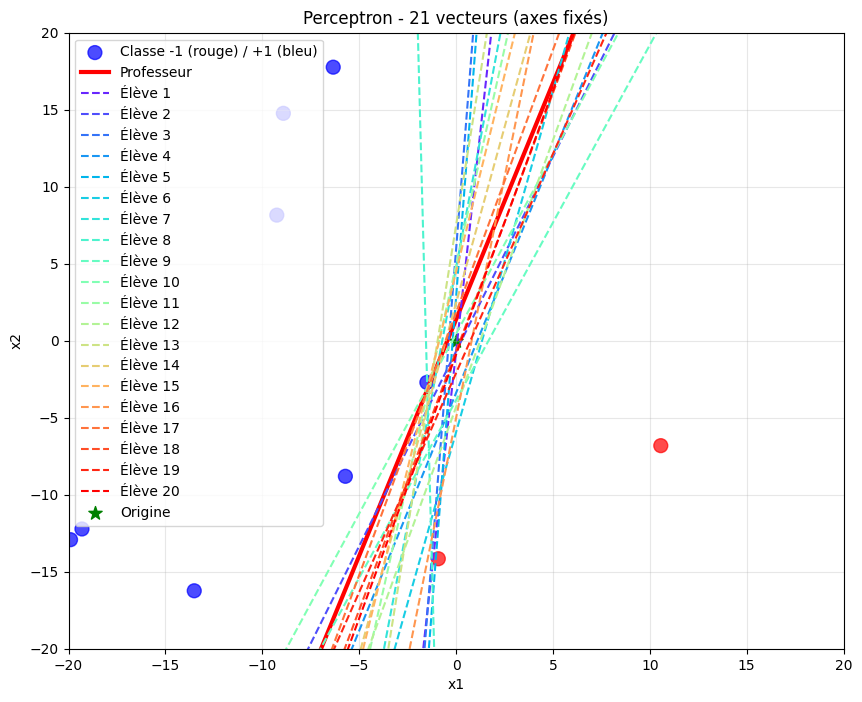

In [70]:
all_array = np.vstack([w_prof,trained_perceptrons])

x_lim = 20
y_lim = 20
plot_L_et_w_multiple_fixed_axes(L_ens, all_array, (-x_lim, x_lim), (-y_lim, y_lim))

In [71]:
df_nbIter=pd.DataFrame(moyennes,columns=['Nbre_iter_convergence', 'Recouvrement R'])
df_nbIter.index.name = 'Perceptron #'
print(df_nbIter)

Nb_iter_moyen, R_moyen = np.mean(moyennes[:, 0]), np.mean(moyennes[:, 1])
print("-"*20, '\n' )
print("Nb_iter_moyen :", Nb_iter_moyen)
print("R_moyen :", R_moyen)

              Nbre_iter_convergence  Recouvrement R
Perceptron #                                       
0                               1.0        0.869672
1                               1.0        0.792196
2                               3.0        0.971456
3                               3.0        0.352387
4                               1.0        0.943879
5                               3.0        0.244688
6                               3.0        0.967679
7                               1.0        0.800067
8                               1.0        0.171014
9                               1.0        0.969344
10                              3.0        0.946554
11                              3.0        0.288846
12                              5.0        0.926242
13                              3.0        0.992937
14                              4.0        0.948171
15                              2.0        0.467139
16                              3.0        0.997063
17          

In [72]:
#Meilleure convergence avec la méthode batch

In [74]:
eta1 = eta0/2
eta2 = eta0/10

algos = ['online','batch']
tests_conf_eta = [eta0, eta1, eta2]
tests_conf_P = [10, 100, 500, 1000]
tests_conf_N = [2, 10, 100, 5000]

param_combinaison = list(product(tests_conf_eta, algos, tests_conf_P, tests_conf_N))

print(param_combinaison)

column_names = ['eta', 'Algorithme', 'Nombre de points P', 'Dimension N']

#Creation du dataframe pour le stockage des paramètres de test
results = pd.DataFrame(param_combinaison, columns=column_names)

#Ajout des deux colonnes pour le stockage des moyennes
results['Avg_nbIter'] = np.nan
results['Avg_R'] = np.nan

print(f"Dimensions du DataFrame (lignes, colonnes) : {results.shape}")
print("-" * 50)
print("Aperçu du DataFrame de Configuration :")
print(results)

[(0.8, 'online', 10, 2), (0.8, 'online', 10, 10), (0.8, 'online', 10, 100), (0.8, 'online', 10, 5000), (0.8, 'online', 100, 2), (0.8, 'online', 100, 10), (0.8, 'online', 100, 100), (0.8, 'online', 100, 5000), (0.8, 'online', 500, 2), (0.8, 'online', 500, 10), (0.8, 'online', 500, 100), (0.8, 'online', 500, 5000), (0.8, 'online', 1000, 2), (0.8, 'online', 1000, 10), (0.8, 'online', 1000, 100), (0.8, 'online', 1000, 5000), (0.8, 'batch', 10, 2), (0.8, 'batch', 10, 10), (0.8, 'batch', 10, 100), (0.8, 'batch', 10, 5000), (0.8, 'batch', 100, 2), (0.8, 'batch', 100, 10), (0.8, 'batch', 100, 100), (0.8, 'batch', 100, 5000), (0.8, 'batch', 500, 2), (0.8, 'batch', 500, 10), (0.8, 'batch', 500, 100), (0.8, 'batch', 500, 5000), (0.8, 'batch', 1000, 2), (0.8, 'batch', 1000, 10), (0.8, 'batch', 1000, 100), (0.8, 'batch', 1000, 5000), (0.4, 'online', 10, 2), (0.4, 'online', 10, 10), (0.4, 'online', 10, 100), (0.4, 'online', 10, 5000), (0.4, 'online', 100, 2), (0.4, 'online', 100, 10), (0.4, 'online'

In [79]:
def make_n_tirages(eta, P, N, nb_tirage, nb_perceptrons, init_range, algo1, algo2):
    #20 Perceptrons aléatoire per paire (N/P) : ils sont initialisés avant la boucle des 100 tirages
    W_perceptrons = init_many_perceptrons(nb_perceptrons, N, init_range)
    w_prof = init_perceptron_prof(N, init_range)

    nb_iter_online_temp = []
    R_online_temp = []

    nb_iter_batch_temp = []
    R_batch_temp = []

    for tir in range(nb_tirage):
        print("tirage n : ", tir, '-'*10, "checkpoint 1")
        #Creation d'un point set per tirage
        points = create_points(P, N, init_range)
        print("tirage n : ", tir, '-'*10, "checkpoint 2")
        
        #Appel fonction d'entraînement des 20 perceptrons en parallèle avec les deux algortime
        algo = 'online'
        _, moyennes_online, _ = make_tirage(W_perceptrons, w_prof, eta, N, P, init_range, algo1, points)
        print("tirage n : ", tir, '-'*10, "checkpoint 3")
        
        nb_iter_online_temp.append(np.mean(moyennes_online[:, 0])) #Moyenne sur les 20 perceptrons entraîné sur le tirage
        R_online_temp.append(np.mean(moyennes_online[:, 1]))
        print("tirage n : ", tir, '-'*10, "checkpoint 4")
        
        algo = 'batch'
        _, moyennes_batch, _ = make_tirage(W_perceptrons, w_prof, eta, N, P, init_range, algo2, points)
        nb_iter_batch_temp.append(np.mean(moyennes_batch[:, 0])) #Idem
        R_batch_temp.append(np.mean(moyennes_batch[:, 1]))
        print("tirage n : ", tir, '-'*10, "checkpoint 5")
        
    #Moyenne sur les 100 tirages
    nb_iter_online_moyen = np.mean(nb_iter_online_temp)
    R_online_moyen = np.mean(R_online_temp)

    nb_iter_batch_moyen = np.mean(nb_iter_batch_temp)
    R_iter_batch_moyen = np.mean(R_batch_temp)

    return nb_iter_online_moyen, R_online_moyen, nb_iter_batch_moyen, R_iter_batch_moyen

In [81]:
eta = eta0
P = 10
N = 2

NB_TIRAGE = 100
NB_PERCEPTRONS = 20
BIAIS_RANGE = (-20, 20)

nb_iter_online, R_online, nb_iter_batch, R_batch = make_n_tirages(
        eta=eta,
        P=P,
        N=N,
        nb_tirage=NB_TIRAGE,
        nb_perceptrons=NB_PERCEPTRONS,
        init_range=BIAIS_RANGE, # Correspond à 'biais_range' dans la fonction
        algo1='online',
        algo2='batch'
    )

print("nb_iter_online : ", nb_iter_online,"\n"
    " R_online : ", R_online,"\n"
    " nb_iter_batch : ", nb_iter_batch,"\n"
    " R_batch: ", R_batch,"\n"
)

tirage n :  0 ---------- checkpoint 1
tirage n :  0 ---------- checkpoint 2
in perceptron online


 ____________________ 

stop = 0
y =  1
t =  -1
y =  1
t =  -1
y =  1
t =  -1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  3


 ____________________ 

stop = 1
y =  -1
t =  -1
y =  1
t =  -1
y =  1
t =  -1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  2


 ____________________ 

stop = 2
y =  -1
t =  -1
y =  1
t =  -1
y =  1
t =  -1
y =  -1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  3


 ____________________ 

stop = 3
y =  -1
t =  -1
y =  1
t =  -1
y =  -1
t =  -1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 4
y =  -1
t =  -1
y =  1
t =  -1
y =  1
t =  -1
y =  -1
t =  

In [77]:
tests_conf_eta = [eta0, eta0/2, eta0/10]
tests_conf_P = [10, 100, 500, 1000]
tests_conf_N = [2, 10, 100, 5000]

# Paramètres globaux pour la simulation
NB_TIRAGE = 1
NB_PERCEPTRONS = 20
BIAIS_RANGE = (-20, 20)

# Création d'un DataFrame temporaire contenant uniquement les combinaisons uniques (eta, P, N)
# Nous filtrons les algorithmes car make_n_tirages les gère en interne.
unique_combinations = pd.DataFrame(
    list(product(tests_conf_eta, tests_conf_P, tests_conf_N)),
    columns=['eta', 'Nombre de points P', 'Dimension N']
)

# Initialisation du DataFrame de résultats final
# Le DataFrame final doit contenir des lignes distinctes pour 'online' et 'batch'.
results_data = []

# --- 2. Boucle de Simulation ---

print("Démarrage des simulations (un appel à make_n_tirages pour chaque combinaison eta/P/N)...")

for index, row in unique_combinations.iterrows():
    eta = row['eta']
    P = int(row['Nombre de points P'])
    N = int(row['Dimension N'])

    print(f"\n--- Running: eta={eta:.4f}, P={P}, N={N} ---")

    # Appel de la fonction pour obtenir les moyennes des 100 tirages pour les deux algos
    nb_iter_online, R_online, nb_iter_batch, R_batch = make_n_tirages(
        eta=eta,
        P=P,
        N=N,
        nb_tirage=NB_TIRAGE,
        nb_perceptrons=NB_PERCEPTRONS,
        init_range=BIAIS_RANGE, # Correspond à 'biais_range' dans la fonction
        algo1='online',
        algo2='batch'
    )

    # 3. Stocker les résultats dans un format adapté au DataFrame final
    # On ajoute DEUX lignes pour chaque appel : une pour 'online' et une pour 'batch'
    
    # Résultat Online
    results_data.append({
        'eta': eta,
        'Algorithme': 'online',
        'Nombre de points P': P,
        'Dimension N': N,
        'Avg_nbIter': nb_iter_online,
        'Avg_R': R_online
    })

    # Résultat Batch
    results_data.append({
        'eta': eta,
        'Algorithme': 'batch',
        'Nombre de points P': P,
        'Dimension N': N,
        'Avg_nbIter': nb_iter_batch,
        'Avg_R': R_batch
    })

# --- 4. Création du DataFrame final ---

# Convertir la liste de résultats en DataFrame
df_results = pd.DataFrame(results_data)

print("\nSimulations terminées.")
print(f"DataFrame de résultats final créé. Shape : {df_results.shape}")
print(df_results.head())





Démarrage des simulations (un appel à make_n_tirages pour chaque combinaison eta/P/N)...

--- Running: eta=0.8000, P=10, N=2 ---
tirage n :  0 ---------- checkpoint 1
tirage n :  0 ---------- checkpoint 2
in perceptron online


 ____________________ 

stop = 0
y =  1
t =  1
y =  -1
t =  -1
y =  -1
t =  -1
y =  -1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 1
y =  1
t =  1
y =  -1
t =  -1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
Convergence atteinte.
in perceptron online - return
in perceptron online


 ____________________ 

stop = 0
y =  -1
t =  1
y =  -1
t =  -1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
nb_mal_classe :  1


 ____________________ 

stop = 1
y =  1
t =  1
y =  -1
t =  -1
y =  -1
t =  -1
y =  1
t =  1
y =  1
t =  1
y =  1
t =  1
y

KeyboardInterrupt: 